In [1]:
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np
import pandas as pd
import csv
import os
import math
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, Dense, GRU, Embedding
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, TensorBoard, ReduceLROnPlateau
from tensorflow.keras.backend import square, mean
from google.colab import drive
drive.mount('/content/drive')
from keras.layers import Dense, LSTM, Dropout, GRU, Bidirectional
from keras.layers import Dense, BatchNormalization
from tensorflow.keras.optimizers import Adam
import pickle
import joblib
from tensorflow import keras

Mounted at /content/drive


In [23]:
df = pd.read_csv('/content/drive/MyDrive/dataset0.1hz.csv', sep=';')
df2 = pd.read_csv('/content/drive/MyDrive/metadata0.1hz.metadata', sep=';')
#df_2 = pd.read_csv('/content/drive/MyDrive/dataset0.01hz-2.csv', sep=';')
#df2_2 = pd.read_csv('/content/drive/MyDrive/metadata0.01hz-2.metadata', sep=';')

In [ ]:
nomi_colonne = df.columns
tipi_dati = {colonna: float for colonna in nomi_colonne}
print(f"dtype{tipi_dati}")

dtype{'time': <class 'float'>, 'sensor_id7_AccX': <class 'float'>, 'sensor_id7_AccY': <class 'float'>, 'sensor_id7_AccZ': <class 'float'>, 'sensor_id7_GyroX': <class 'float'>, 'sensor_id7_GyroY': <class 'float'>, 'sensor_id7_GyroZ': <class 'float'>, 'sensor_id2_AccX': <class 'float'>, 'sensor_id2_AccY': <class 'float'>, 'sensor_id2_AccZ': <class 'float'>, 'sensor_id6_AccX': <class 'float'>, 'sensor_id6_AccY': <class 'float'>, 'sensor_id6_AccZ': <class 'float'>, 'sensor_id1_AngX': <class 'float'>, 'sensor_id6_GyroX': <class 'float'>, 'sensor_id1_AngY': <class 'float'>, 'sensor_id6_GyroY': <class 'float'>, 'sensor_id1_AngZ': <class 'float'>, 'sensor_id6_GyroZ': <class 'float'>, 'sensor_id1_temp': <class 'float'>, 'sensor_id4_AngX': <class 'float'>, 'sensor_id4_AngY': <class 'float'>, 'sensor_id4_AngZ': <class 'float'>, 'sensor_id4_temp': <class 'float'>, 'sensor_id5_AngX': <class 'float'>, 'sensor_id3_AccX': <class 'float'>, 'sensor_id3_AccY': <class 'float'>, 'sensor_id3_AccZ': <class '

In [ ]:
prima_riga = df.iloc[0]

# Itera attraverso ciascun elemento nella prima riga e stampa il suo tipo
for valore in prima_riga:
    tipo_dato = type(valore)
    print(valore)
    print(f"Tipo di dato: {tipo_dato}")

2023-02-10T15:20:05.318016+00:00
Tipo di dato: <class 'str'>
-0.0625
Tipo di dato: <class 'numpy.float64'>
-0.06640625
Tipo di dato: <class 'numpy.float64'>
-1.01953125
Tipo di dato: <class 'numpy.float64'>
0.0
Tipo di dato: <class 'numpy.float64'>
0.0
Tipo di dato: <class 'numpy.float64'>
0.0
Tipo di dato: <class 'numpy.float64'>
0.001953125
Tipo di dato: <class 'numpy.float64'>
-0.00439453125
Tipo di dato: <class 'numpy.float64'>
1.00146484375
Tipo di dato: <class 'numpy.float64'>
0.0
Tipo di dato: <class 'numpy.float64'>
0.0
Tipo di dato: <class 'numpy.float64'>
0.0
Tipo di dato: <class 'numpy.float64'>
0.12353515625
Tipo di dato: <class 'numpy.float64'>
-0.58154296875
Tipo di dato: <class 'numpy.float64'>
0.7900390625
Tipo di dato: <class 'numpy.float64'>
-136.3623046875
Tipo di dato: <class 'numpy.float64'>
-1.4501953125
Tipo di dato: <class 'numpy.float64'>
-13.4912109375
Tipo di dato: <class 'numpy.float64'>
144.12
Tipo di dato: <class 'numpy.float64'>
0.0302734375
Tipo di dato:

In [ ]:
#MANTENGO NEI DUE DATASET SOLO LE COLONNE CHE SONO PRESENTI IN ENTRAMBI
flag = 0
for column in df:
  flag = 0
  for column2 in df_2:
    if column == column2:
      flag = 1
  if flag == 0:
    df = df.drop(column, axis = 1)

In [ ]:
df.shape

(15538, 122)

In [24]:
#ELIMINO LE RIGHE CHE PRESENTANO DEI VALORI NULLI
df2 = df2.dropna()
'''
df2_2 = df2_2.dropna()
'''

'\ndf2_2 = df2_2.dropna()\n'

In [25]:
df = df.dropna()
'''
df_2 = df_2.dropna()
'''

'\ndf_2 = df_2.dropna()\n'

In [26]:
df.shape

(15538, 122)

In [27]:
#ELIMINO LE COLONNE CHE PRESENTANO UN SOLO VALORE
for column in df:
  if df[column].nunique() <= 3:
    df = df.drop(column,axis = 1)

'''
for column in df_2:
  if df_2[column].nunique() == 1:
    df_2 = df_2.drop(column,axis = 1)
 '''

'\nfor column in df_2:\n  if df_2[column].nunique() == 1:\n    df_2 = df_2.drop(column,axis = 1)\n '

In [28]:
colonne_temp = [col for col in df.columns if 'temp' in col]

# Elimina le colonne contenenti 'temp'
df = df.drop(columns=colonne_temp)


In [29]:
df_diff = df['machine_nameKuka Robot_import_active_energy'].diff()
print(df_diff)

0        NaN
1        0.0
2        0.0
3        0.0
4        0.0
        ... 
15533    0.0
15534    0.0
15535    0.0
15536    0.0
15537    0.0
Name: machine_nameKuka Robot_import_active_energy, Length: 15538, dtype: float64


In [30]:
valore = 0
df_diff = df['machine_nameKuka Robot_import_active_energy'].diff()

inizio =df_diff.index[0]
for index,value in enumerate(df_diff):
  if (value != 0 and not np.isnan(value)) or index == df_diff.index[-1]:
    fine = index + 1
    for indice2, valore2 in enumerate(df_diff):
      if indice2 < fine and indice2 >= inizio :
        df_diff[indice2] = value
    inizio = fine

df['machine_nameKuka Robot_import_active_energy'] = df_diff




In [ ]:
for value in df_diff:
  print(value)

Output streaming troncato alle ultime 5000 righe.
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.0009759999998095736
0.00

In [ ]:

valori_da_graficare = df['machine_nameKuka Robot_import_reactive_energy']
# Creare il grafico utilizzando i valori estratti
plt.plot(valori_da_graficare)

In [32]:

df_diff = df['machine_nameKuka Robot_export_reactive_energy'].diff()
inizio =df_diff.index[0]
for index,value in enumerate(df_diff):
  if (value != 0 and not np.isnan(value)) or index == df_diff.index[-1]:
    fine = index + 1
    for indice2, valore2 in enumerate(df_diff):
      if indice2 < fine and indice2 >= inizio :
        df_diff[indice2] = value
    inizio = fine

df['machine_nameKuka Robot_import_reactive_energy'] = df_diff


In [33]:
#ELIMINO LE RIGHE CHE PRESENTANO DEI VALORI NON IDENTIFICATI DA UN'OPERAZIONE O OPERAZIONI CHE NON PRESENTANO LE SPECIFICHE NEL CSV
print(len(df))
for index,value in df.iterrows():
  if value['time'] > df2['completed_timestamp'][df2.index[-1]] or value['time'] < df2['init_timestamp'][0] :
    df.drop(index,inplace=True)
print(len(df))



print(len(df2))
for index,value in df2.iterrows():
  if value['init_timestamp'] < df['time'][df.index[0]] or value['completed_timestamp'] > df['time'][df.index[-1]]:
    df2 = df2.drop(index = index,axis = 0)
print(len(df2))


15538
15472
208
154


In [ ]:
print(len(df_2))
for index,value in df_2.iterrows():
  if value['time'] > df2_2['completed_timestamp'][df2_2.index[-1]] or value['time'] < df2_2['init_timestamp'][0] :
    df_2.drop(index,inplace=True)
print(len(df_2))



print(len(df2_2))
for index,value in df2_2.iterrows():
  if value['init_timestamp'] < df_2['time'][df_2.index[0]] or value['completed_timestamp'] > df_2['time'][df_2.index[-1]]:
    df2_2 = df2_2.drop(index = index,axis = 0)
print(len(df2_2))


228591
228584
206
182


In [34]:
#INSERISCO IN UN INSIEME LE OPERAZIONI UNIVOCHE
operazioni_univoche = set()
for index, row in df2.iterrows():
    operazioni_univoche.add(row['str_repr'])

'''
operazioni_univoche_2 = set()
for index, row in df2_2.iterrows():
    operazioni_univoche_2.add(row['str_repr'])
    '''

"\noperazioni_univoche_2 = set()\nfor index, row in df2_2.iterrows():\n    operazioni_univoche_2.add(row['str_repr'])\n    "

In [35]:
operazioni = []
for index, value in df2.iterrows():
    operazioni.append(value['str_repr'])
print(len(operazioni))

'''
operazioni_2 = []
for index, value in df2_2.iterrows():
    operazioni_2.append(value['str_repr'])
print(len(operazioni_2))
'''

154


"\noperazioni_2 = []\nfor index, value in df2_2.iterrows():\n    operazioni_2.append(value['str_repr'])\nprint(len(operazioni_2))\n"

In [36]:
working_time_start = []
for tempo in df2['init_timestamp']:
  if tempo > df['time'][df.index[0]] and tempo < df['time'][len(df)-1]:
    working_time_start.append(tempo)

print(working_time_start)


'''
working_time_start_2 = []
for tempo in df2_2['init_timestamp']:
  if tempo > df_2['time'][df_2.index[0]] and tempo < df_2['time'][df_2.index[-1]]:
    working_time_start_2.append(tempo)

print(working_time_start_2)
'''

['2023-02-15T10:28:51.446291+00:00', '2023-02-15T10:29:04.450320+00:00', '2023-02-15T10:29:17.460980+00:00', '2023-02-15T10:29:28.462537+00:00', '2023-02-15T10:29:39.472281+00:00', '2023-02-15T10:29:50.480747+00:00', '2023-02-15T10:30:01.544803+00:00', '2023-02-15T10:30:12.496410+00:00', '2023-02-15T10:30:23.496070+00:00', '2023-02-15T10:30:32.505495+00:00', '2023-02-15T10:30:41.515411+00:00', '2023-02-15T10:30:50.513037+00:00', '2023-02-15T10:30:59.520255+00:00', '2023-02-15T10:31:08.526457+00:00', '2023-02-15T10:31:18.530945+00:00', '2023-02-15T10:31:28.549671+00:00', '2023-02-15T10:31:38.553147+00:00', '2023-02-15T10:31:48.548850+00:00', '2023-02-15T10:31:58.571917+00:00', '2023-02-15T10:32:08.563729+00:00', '2023-02-15T10:32:17.583725+00:00', '2023-02-15T10:32:26.582475+00:00', '2023-02-15T10:32:35.596745+00:00', '2023-02-15T10:32:44.584812+00:00', '2023-02-15T10:32:54.592600+00:00', '2023-02-15T10:33:04.636761+00:00', '2023-02-15T10:33:14.605078+00:00', '2023-02-15T10:33:24.618569

"\nworking_time_start_2 = []\nfor tempo in df2_2['init_timestamp']:\n  if tempo > df_2['time'][df_2.index[0]] and tempo < df_2['time'][df_2.index[-1]]:\n    working_time_start_2.append(tempo)\n\nprint(working_time_start_2)\n"

In [37]:
working_time_end = []
for tempo_init,tempo_fin in zip(df2['init_timestamp'],df2['completed_timestamp']):
  for time_work in working_time_start:
    if time_work == tempo_init:
      working_time_end.append(tempo_fin)

print(working_time_end)

'''
working_time_end_2 = []
for tempo_init,tempo_fin in zip(df2_2['init_timestamp'],df2_2['completed_timestamp']):
  for time_work in working_time_start_2:
    if time_work == tempo_init:
      working_time_end_2.append(tempo_fin)

print(working_time_end_2)
'''

['2023-02-15T10:29:04.450320+00:00', '2023-02-15T10:29:17.460980+00:00', '2023-02-15T10:29:28.462537+00:00', '2023-02-15T10:29:39.472281+00:00', '2023-02-15T10:29:50.480747+00:00', '2023-02-15T10:30:01.544803+00:00', '2023-02-15T10:30:12.496410+00:00', '2023-02-15T10:30:23.496070+00:00', '2023-02-15T10:30:32.505495+00:00', '2023-02-15T10:30:41.515411+00:00', '2023-02-15T10:30:50.513037+00:00', '2023-02-15T10:30:59.520255+00:00', '2023-02-15T10:31:08.526457+00:00', '2023-02-15T10:31:18.530945+00:00', '2023-02-15T10:31:28.549671+00:00', '2023-02-15T10:31:38.553147+00:00', '2023-02-15T10:31:48.548850+00:00', '2023-02-15T10:31:58.571917+00:00', '2023-02-15T10:32:08.563729+00:00', '2023-02-15T10:32:17.583725+00:00', '2023-02-15T10:32:26.582475+00:00', '2023-02-15T10:32:35.596745+00:00', '2023-02-15T10:32:44.584812+00:00', '2023-02-15T10:32:54.592600+00:00', '2023-02-15T10:33:04.636761+00:00', '2023-02-15T10:33:14.605078+00:00', '2023-02-15T10:33:24.618569+00:00', '2023-02-15T10:33:34.620112

"\nworking_time_end_2 = []\nfor tempo_init,tempo_fin in zip(df2_2['init_timestamp'],df2_2['completed_timestamp']):\n  for time_work in working_time_start_2:\n    if time_work == tempo_init:\n      working_time_end_2.append(tempo_fin)\n\nprint(working_time_end_2)\n"

In [38]:
#INSERISCO L'OPERAZIONE NEL CORRISPONDENTE CSV
lista = []
flag = 0
for value in df['time']:
  flag = 0
  for operazione,inizio,fine in zip(operazioni,working_time_start,working_time_end):
    if value >= inizio and value<= fine:
      lista.append(operazione)
      flag = 1
      break
  if flag == 0:
      lista.append('0')

print(len(lista))
df['operazione'] = lista


'''
lista_2 = []
flag = 0
for index,value in df_2.iterrows():
  flag = 0
  for operazione,inizio,fine in zip(operazioni_2,working_time_start_2,working_time_end_2):
    if value['time'] >= inizio and value['time'] <= fine:
      lista_2.append(operazione)
      flag = 1
      break
  if flag == 0:
      lista_2.append('0')

print(len(lista_2))
df_2['operazione'] = lista_2
'''

15472


"\nlista_2 = []\nflag = 0\nfor index,value in df_2.iterrows():\n  flag = 0\n  for operazione,inizio,fine in zip(operazioni_2,working_time_start_2,working_time_end_2):\n    if value['time'] >= inizio and value['time'] <= fine:\n      lista_2.append(operazione)\n      flag = 1\n      break\n  if flag == 0:\n      lista_2.append('0')\n\nprint(len(lista_2))\ndf_2['operazione'] = lista_2\n"

In [ ]:
print(lista_2)

['0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', 'placeToPallet(1,2)=[true,0]', 'placeToPallet(1,2)=[true,0]', 'placeToPallet(1,2)=[true,0]', 'placeToPallet(1,2)=[true,0]', 'placeToPallet(1,2)=[true,0]', 'placeToPallet(1,2)=[true,0]', 'placeToPallet(1,2)=[true,0]', 'placeToPallet(1,2)=[true,0]', 'placeToPallet(1,2)=[true,0]', 'placeToPallet(1,2)=[true,0]', 'placeToPallet(1,2)=[true,0]', 'placeToPallet(1,2)=[true,0]', 'placeToPallet(1,2)=[true,0]', 'placeToPallet(1,2)=[true,0]', 'placeToPallet(1,2)=[true,0]', 'placeToP

In [39]:
#ELIMINO LE RIGHE CHE NON HANNO UN'OPERAZIONE ASSOCIATA
print(len(df))
for index,value in df['operazione'].iteritems():
  if value == '0':
    df = df.drop(index)
print(len(df))

'''
print(len(df_2))
for index,value in df_2.iterrows():
  if value['operazione'] == '0':
    df_2 = df_2.drop(index)
print(len(df_2))
'''

15472


<ipython-input-39-d4fcd51b9619>:3: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for index,value in df['operazione'].iteritems():


15292


"\nprint(len(df_2))\nfor index,value in df_2.iterrows():\n  if value['operazione'] == '0':\n    df_2 = df_2.drop(index)\nprint(len(df_2))\n"

In [ ]:
df_2.head()

,time,sensor_id5_GyroX,sensor_id4_AccX,sensor_id4_AccY,sensor_id5_GyroY,sensor_id4_AccZ,sensor_id5_GyroZ,sensor_id5_AngX,sensor_id5_AngY,sensor_id5_AngZ,...,machine_nameKuka Robot_voltage,machine_nameKuka Robot_current,machine_nameKuka Robot_power,machine_nameKuka Robot_apparent_power,machine_nameKuka Robot_reactive_power,machine_nameKuka Robot_power_factor,machine_nameKuka Robot_phase_angle,machine_nameKuka Robot_frequency,machine_nameKuka Robot_import_active_energy,machine_nameKuka Robot_export_reactive_energy
0,2021-12-10T15:58:23.008903+00:00,2.075195,0.215820,-0.923828,-8.483887,0.563477,43.090820,-153.709717,-25.823364,-7.679443,...,228.445389,1.201105,189.01265,216.610596,-105.793724,0.872592,330.759125,50.0,2158.995117,1835.827026
1,2021-12-10T15:58:23.018903+00:00,3.906250,0.351562,-0.614746,-6.591797,0.646484,43.273926,-153.522949,-25.576172,-8.085938,...,228.445389,1.201105,189.01265,216.610596,-105.793724,0.872592,330.759125,50.0,2158.995117,1835.827026
2,2021-12-10T15:58:23.028903+00:00,1.403809,0.158691,-0.657715,-7.446289,0.793457,44.189453,-153.237305,-25.219116,-8.706665,...,228.445389,1.201105,189.01265,216.610596,-105.793724,0.872592,330.759125,50.0,2158.995117,1835.827026
3,2021-12-10T15:58:23.038903+00:00,-3.356934,-0.260254,-0.605469,-7.385254,0.747559,44.372559,-153.099976,-24.966431,-9.113159,...,228.445389,1.201105,189.01265,216.610596,-105.793724,0.872592,330.759125,50.0,2158.995117,1835.827026
4,2021-12-10T15:58:23.048903+00:00,-6.103516,-0.134277,-0.717773,1.098633,0.673828,40.405273,-152.995605,-24.779663,-9.525146,...,228.445389,1.201105,189.01265,216.610596,-105.793724,0.872592,330.759125,50.0,2158.995117,1835.827026


In [ ]:
df.head()

df_2.head()

,time,sensor_id5_GyroX,sensor_id4_AccX,sensor_id4_AccY,sensor_id5_GyroY,sensor_id4_AccZ,sensor_id5_GyroZ,sensor_id5_AngX,sensor_id5_AngY,sensor_id5_AngZ,...,machine_nameKuka Robot_voltage,machine_nameKuka Robot_current,machine_nameKuka Robot_power,machine_nameKuka Robot_apparent_power,machine_nameKuka Robot_reactive_power,machine_nameKuka Robot_power_factor,machine_nameKuka Robot_phase_angle,machine_nameKuka Robot_frequency,machine_nameKuka Robot_import_active_energy,machine_nameKuka Robot_export_reactive_energy
0,2021-12-10T15:58:23.008903+00:00,2.075195,0.215820,-0.923828,-8.483887,0.563477,43.090820,-153.709717,-25.823364,-7.679443,...,228.445389,1.201105,189.01265,216.610596,-105.793724,0.872592,330.759125,50.0,2158.995117,1835.827026
1,2021-12-10T15:58:23.018903+00:00,3.906250,0.351562,-0.614746,-6.591797,0.646484,43.273926,-153.522949,-25.576172,-8.085938,...,228.445389,1.201105,189.01265,216.610596,-105.793724,0.872592,330.759125,50.0,2158.995117,1835.827026
2,2021-12-10T15:58:23.028903+00:00,1.403809,0.158691,-0.657715,-7.446289,0.793457,44.189453,-153.237305,-25.219116,-8.706665,...,228.445389,1.201105,189.01265,216.610596,-105.793724,0.872592,330.759125,50.0,2158.995117,1835.827026
3,2021-12-10T15:58:23.038903+00:00,-3.356934,-0.260254,-0.605469,-7.385254,0.747559,44.372559,-153.099976,-24.966431,-9.113159,...,228.445389,1.201105,189.01265,216.610596,-105.793724,0.872592,330.759125,50.0,2158.995117,1835.827026
4,2021-12-10T15:58:23.048903+00:00,-6.103516,-0.134277,-0.717773,1.098633,0.673828,40.405273,-152.995605,-24.779663,-9.525146,...,228.445389,1.201105,189.01265,216.610596,-105.793724,0.872592,330.759125,50.0,2158.995117,1835.827026


In [40]:
#ASSOCIO AD OGNI OPERAZIONE UN IDENTIFICATORE
cont = 0
dizionario_operazioni = {}
for operazione in operazioni_univoche:
  for index,value in df['operazione'].iteritems():
    if operazione == value:
      dizionario_operazioni[operazione] = cont
      df.at[index, 'operazione'] = cont
  cont +=1

'''
cont = 0
dizionario_operazioni_2 = {}
for operazione in operazioni_univoche_2:
  for index,value in df_2.iterrows():
    if operazione == value['operazione']:
      dizionario_operazioni_2[operazione] = cont
      df_2.at[index, 'operazione'] = cont
  cont +=1
  '''

<ipython-input-40-5251f3665a78>:5: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for index,value in df['operazione'].iteritems():


"\ncont = 0\ndizionario_operazioni_2 = {}\nfor operazione in operazioni_univoche_2:\n  for index,value in df_2.iterrows():\n    if operazione == value['operazione']:\n      dizionario_operazioni_2[operazione] = cont\n      df_2.at[index, 'operazione'] = cont\n  cont +=1\n  "

In [41]:
df = df.drop('time',axis=1)
#df = df.drop('operazione',axis=1)
'''
df_2 = df_2.drop('time',axis=1)
'''

"\ndf_2 = df_2.drop('time',axis=1)\n"

In [42]:
columns = df.columns.tolist()

In [ ]:
with open('/content/drive/MyDrive/training_set.csv', mode='w', newline='') as file_csv:
  writer = csv.writer(file_csv)
  writer.writerow(df_2.columns)
  for index,column in df_2.iterrows():
    writer.writerow(column)

In [ ]:
with open('/content/drive/MyDrive/training_set-2.csv', mode='w', newline='') as file_csv:
  writer = csv.writer(file_csv)
  writer.writerow(df.columns)
  for index,column in df.iterrows():
    writer.writerow(column)

In [ ]:
with open('/content/drive/MyDrive/training_set-2.csv', mode='w', newline='') as file_csv:
  writer = csv.writer(file_csv)
  writer.writerow(df.columns)
  for index,column in df.iterrows():
    writer.writerow(column)

In [ ]:
df.head()

,sensor_id7_AccX,sensor_id7_AccY,sensor_id7_AccZ,sensor_id7_GyroX,sensor_id7_GyroY,sensor_id7_GyroZ,sensor_id2_AccX,sensor_id2_AccY,sensor_id2_AccZ,sensor_id6_AccX,...,machine_nameKuka Robot_voltage,machine_nameKuka Robot_current,machine_nameKuka Robot_power,machine_nameKuka Robot_apparent_power,machine_nameKuka Robot_reactive_power,machine_nameKuka Robot_power_factor,machine_nameKuka Robot_phase_angle,machine_nameKuka Robot_import_active_energy,machine_nameKuka Robot_export_reactive_energy,operazione
90,0.002930,-0.002930,1.000977,0.00000,0.061035,0.0,0.488281,0.035645,0.838867,0.030273,...,232.769226,1.180791,234.020340,259.613159,-112.388466,0.901419,334.343384,2158.150879,1835.267944,28
91,0.004395,-0.004883,0.999512,0.12207,0.122070,0.0,0.488281,0.035156,0.838867,0.031250,...,232.769226,1.180791,234.020340,259.613159,-112.388466,0.901419,334.343384,2158.150879,1835.267944,28
92,0.003418,-0.003906,1.000977,0.00000,-0.061035,0.0,0.488281,0.036621,0.838867,0.034668,...,233.211075,0.883627,161.440994,185.046799,-90.430183,0.872433,330.740509,2158.150879,1835.267944,28
93,0.002930,-0.006348,0.999512,0.00000,-0.061035,0.0,0.488770,0.036133,0.836914,0.030762,...,233.211075,0.883627,161.440994,185.046799,-90.430183,0.872433,330.740509,2158.150879,1835.267944,28
94,0.006348,-0.004395,1.000977,0.00000,0.061035,0.0,0.488770,0.036621,0.838867,0.031738,...,233.211075,0.883627,161.440994,185.046799,-90.430183,0.872433,330.740509,2158.150879,1835.267944,28


In [ ]:
df.tail()

,sensor_id7_AccX,sensor_id7_AccY,sensor_id7_AccZ,sensor_id7_GyroX,sensor_id7_GyroY,sensor_id7_GyroZ,sensor_id2_AccX,sensor_id2_AccY,sensor_id2_AccZ,sensor_id6_AccX,...,machine_nameKuka Robot_current,machine_nameKuka Robot_power,machine_nameKuka Robot_apparent_power,machine_nameKuka Robot_reactive_power,machine_nameKuka Robot_power_factor,machine_nameKuka Robot_phase_angle,machine_nameKuka Robot_import_active_energy,machine_nameKuka Robot_export_reactive_energy,collisionState,operazione
307623,0.005371,-0.002930,0.9990234375,0.0,0.1220703125,0.0,0.48779296875,0.03515625,0.83935546875,0.033203,...,0.890357,161.517.914,184.412.811,-88.986.519,0.87585,331.143.585,2.158.230.957,1.835.312.012,4.0,25
307624,0.005371,-0.004883,100.146.484.375,0.0,0.0,0.0,0.48876953125,0.03564453125,0.837890625,0.028809,...,0.890357,161.517.914,184.412.811,-88.986.519,0.87585,331.143.585,2.158.230.957,1.835.312.012,4.0,25
307625,0.002930,-0.003418,100.146.484.375,0.06103515625,0.18310546875,0.0,0.48974609375,0.03857421875,0.8369140625,0.028320,...,0.890357,161.517.914,184.412.811,-88.986.519,0.87585,331.143.585,2.158.230.957,1.835.312.012,4.0,25
307626,0.001465,-0.003418,100.146.484.375,0.06103515625,0.18310546875,0.0,0.48974609375,0.03515625,0.8408203125,0.030273,...,0.890357,161.517.914,184.412.811,-88.986.519,0.87585,331.143.585,2.158.230.957,1.835.312.012,4.0,25
307627,0.004883,-0.006348,100.341.796.875,0.0,0.18310546875,0.0,0.48828125,0.03466796875,0.83740234375,0.029785,...,0.890357,161.517.914,184.412.811,-88.986.519,0.87585,331.143.585,2.158.230.957,1.835.312.012,4.0,25


In [3]:
df = pd.read_csv('/content/drive/MyDrive/training_set.csv', sep=',')

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/training_set-2.csv', sep=',')

In [ ]:
df_2 = df_2.drop('operazione', axis = 1)

In [43]:
df.shape

(15292, 98)

In [ ]:
df_2.head()

,sensor_id7_AccX,sensor_id7_AccY,sensor_id7_AccZ,sensor_id7_GyroX,sensor_id7_GyroY,sensor_id7_GyroZ,sensor_id2_AccX,sensor_id2_AccY,sensor_id2_AccZ,sensor_id6_AccX,...,machine_nameKuka Robot_current,machine_nameKuka Robot_power,machine_nameKuka Robot_apparent_power,machine_nameKuka Robot_reactive_power,machine_nameKuka Robot_power_factor,machine_nameKuka Robot_phase_angle,machine_nameKuka Robot_import_active_energy,machine_nameKuka Robot_export_reactive_energy,collisionState,operazione
0,0.002441,-0.001465,0.9990234375,0.0,0.1220703125,0.0,0.48681640625,0.0361328125,0.84033203125,0.030762,...,1.180.791,23.402.034,259.613.159,-112.388.466,0.901419,334.343.384,2.158.150.879,1.835.267.944,4.0,8
1,0.004395,-0.004883,100.146.484.375,0.0,-0.06103515625,0.0,0.4892578125,0.03466796875,0.83984375,0.031250,...,1.180.791,23.402.034,259.613.159,-112.388.466,0.901419,334.343.384,2.158.150.879,1.835.267.944,4.0,8
2,0.003418,-0.004395,100.146.484.375,0.0,-0.1220703125,0.0,0.4892578125,0.03369140625,0.8388671875,0.030273,...,1.180.791,23.402.034,259.613.159,-112.388.466,0.901419,334.343.384,2.158.150.879,1.835.267.944,4.0,8
3,0.002930,-0.000977,1.0,0.0,-0.06103515625,0.0,0.48779296875,0.03466796875,0.83935546875,0.032715,...,1.180.791,23.402.034,259.613.159,-112.388.466,0.901419,334.343.384,2.158.150.879,1.835.267.944,4.0,8
4,0.003418,-0.004395,0.9990234375,-0.06103515625,0.18310546875,0.0,0.48974609375,0.03515625,0.84033203125,0.030273,...,1.180.791,23.402.034,259.613.159,-112.388.466,0.901419,334.343.384,2.158.150.879,1.835.267.944,4.0,8


In [44]:
#PREPARO I DATI PER IL MODELLO
x_data = df.values
y_data = df.values


num_data = len(x_data)
num_train = int((len(df)/100)*80)
num_test = len(df) - num_train

x_train = x_data[0:num_train]
print(len(x_train))
x_test = x_data[num_train:]

y_train = y_data[0:num_train]
y_test = y_data[num_train:]


num_data = len(x_train) #numero righe
print(num_data)
num_x_signals = x_train.shape[1] #numero colonne


num_y_signals = y_train.shape[1]

12233
12233


In [45]:
print("Min:", np.min(x_train))
print("Max:", np.max(x_train))


x_scaler = MinMaxScaler()

x_train_scaled = x_scaler.fit_transform(x_train)


print("Min:", np.min(x_train_scaled))
print("Max:", np.max(x_train_scaled))

x_test_scaled = x_scaler.transform(x_test)

y_scaler = MinMaxScaler()
y_train_scaled = y_scaler.fit_transform(y_train)
y_test_scaled = y_scaler.transform(y_test)

Min: -981.14013671875
Max: 1835.303955
Min: 0.0
Max: 1.0000000000000004


In [46]:
def batch_generator(batch_size , input_rows , output_rows):
    """
    Generator function for creating random batches of training-data.
    """

    # Infinite loop.
    while True:
        # Allocate a new array for the batch of input-signals.
        x_shape = (batch_size, input_rows, num_x_signals)
        x_batch = np.zeros(shape=x_shape, dtype=np.float16)

        # Allocate a new array for the batch of output-signals.
        y_shape = (batch_size, output_rows, num_y_signals)
        y_batch = np.zeros(shape=y_shape, dtype=np.float16)

        # Fill the batch with random sequences of data.
        for i in range(batch_size):
            # Get a random start-index.
            # This points somewhere into the training-data.
            idx = np.random.randint(num_data - input_rows - output_rows)
            # Copy the sequences of data starting at this index.
            x_batch[i] = x_train_scaled[idx : idx + input_rows]

            y_batch[i] = x_train_scaled[idx + input_rows : idx + input_rows + output_rows]

        yield (x_batch, y_batch)


In [47]:
batch_size = 200 #256
input_rows = 10 #200
output_rows = 10  #200
generator = batch_generator(batch_size=batch_size, input_rows = input_rows, output_rows = output_rows)

x_batch, y_batch = next(generator)

In [48]:
validation_data = (np.expand_dims(x_test_scaled, axis=0),
                   np.expand_dims(y_test_scaled, axis=0))

In [ ]:
'''
model = Sequential()
model.add(GRU(units=512,
              return_sequences=True,
              input_shape=(None, num_x_signals,)))
model.add(Dense(num_y_signals, activation='sigmoid'))
'''

"\nmodel = Sequential()\nmodel.add(GRU(units=512,\n              return_sequences=True,\n              input_shape=(None, num_x_signals,)))\nmodel.add(Dense(num_y_signals, activation='sigmoid'))\n"

In [49]:
model = Sequential()
model.add(GRU(units=512, return_sequences=True, input_shape=(None, num_x_signals)))
model.add(Dropout(0.2))
model.add(GRU(units=512, return_sequences=True))
model.add(Dropout(0.2))
model.add(Dense(num_y_signals, activation='sigmoid'))

In [50]:
if False:
    from tensorflow.python.keras.initializers import RandomUniform

    # Maybe use lower init-ranges.
    init = RandomUniform(minval=-0.05, maxval=0.05)

    model.add(Dense(num_y_signals,
                    activation='linear',
                    kernel_initializer=init))

In [51]:
warmup_steps = 50

In [52]:
def loss_mse_warmup(y_true, y_pred):
    """
    Calculate the Mean Squared Error between y_true and y_pred,
    but ignore the beginning "warmup" part of the sequences.

    y_true is the desired output.
    y_pred is the model's output.
    """

    # The shape of both input tensors are:
    # [batch_size, sequence_length, num_y_signals].

    # Ignore the "warmup" parts of the sequences
    # by taking slices of the tensors.
    y_true_slice = y_true[:, warmup_steps:, :]
    y_pred_slice = y_pred[:, warmup_steps:, :]

    # These sliced tensors both have this shape:
    # [batch_size, sequence_length - warmup_steps, num_y_signals]

    # Calculat the Mean Squared Error and use it as loss.
    mse = mean(square(y_true_slice - y_pred_slice))

    return mse

In [ ]:
'''
optimizer = RMSprop(lr=1e-3)
model.compile(loss='mse', optimizer=optimizer)
'''

"\noptimizer = RMSprop(lr=1e-3)\nmodel.compile(loss='mse', optimizer=optimizer)\n"

In [53]:
optimizer = Adam(lr=1e-3)  # Imposta il learning rate a 0.001 (puoi sperimentare con valori diversi)
model.compile(loss='mse', optimizer=optimizer)

In [54]:
path_checkpoint = '23_checkpoint.keras'
callback_checkpoint = ModelCheckpoint(filepath=path_checkpoint,
                                      monitor='val_loss',
                                      verbose=1,
                                      save_weights_only=True,
                                      save_best_only=True)
callback_early_stopping = EarlyStopping(monitor='val_loss',
                                        patience=5, verbose=1)
callback_tensorboard = TensorBoard(log_dir='./23_logs/',
                                   histogram_freq=0,
                                   write_graph=False)
callback_reduce_lr = ReduceLROnPlateau(monitor='val_loss',
                                       factor=0.1,
                                       min_lr=1e-4,
                                       patience=0,
                                       verbose=1)
callbacks = [callback_early_stopping,
             callback_checkpoint,
             callback_tensorboard,
             callback_reduce_lr]

In [ ]:
model = keras.models.load_model('modelloprova')

In [55]:
epochs=20
model.fit(x=generator,
          epochs=epochs,
          steps_per_epoch=100,
          validation_data=validation_data,
          callbacks=callbacks
          )

Epoch 1/20
100/100 [==============================] - ETA: 0s - loss: 0.0225
Epoch 1: val_loss improved from inf to 0.02797, saving model to 23_checkpoint.keras
100/100 [==============================] - 90s 853ms/step - loss: 0.0225 - val_loss: 0.0280 - lr: 0.0010
Epoch 2/20
100/100 [==============================] - ETA: 0s - loss: 0.0134
Epoch 2: val_loss improved from 0.02797 to 0.02729, saving model to 23_checkpoint.keras
100/100 [==============================] - 83s 835ms/step - loss: 0.0134 - val_loss: 0.0273 - lr: 0.0010
Epoch 3/20
100/100 [==============================] - ETA: 0s - loss: 0.0110
Epoch 3: val_loss did not improve from 0.02729

Epoch 3: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.
100/100 [==============================] - 87s 875ms/step - loss: 0.0110 - val_loss: 0.0297 - lr: 0.0010
Epoch 4/20
100/100 [==============================] - ETA: 0s - loss: 0.0100
Epoch 4: val_loss did not improve from 0.02729

Epoch 4: ReduceLROnPlateau reduc

In [ ]:
joblib.dump(model , 'modello_prova2.pkl')

['modello_prova2.pkl']

In [ ]:
model.save('modelloprova0.005')

In [ ]:
model = joblib.load('/content/modello_prova2.pkl')

In [ ]:
new_obs = ['valori da predirre']

In [ ]:
classifier.predict(new obs)

In [56]:
result = model.evaluate(x=np.expand_dims(x_test_scaled, axis=0),
                        y=np.expand_dims(y_test_scaled, axis=0))

print("loss (test-set):", result)

1/1 [==============================] - 3s 3s/step - loss: 0.0318
loss (test-set): 0.03184064105153084


In [ ]:
try:
    model.load_weights(path_checkpoint)
except Exception as error:
    print("Error trying to load checkpoint.")
    print(error)

In [57]:
def plot_comparison(start_idx, length, train=True):
    """
    Plot the predicted and true output-signals.

    :param start_idx: Start-index for the time-series.
    :param length: Sequence-length to process and plot.
    :param train: Boolean whether to use training- or test-set.
    """

    if train:
        # Use training-data.
        x = x_train_scaled
        y_true = y_train
    else:
        # Use test-data.
        x = x_test_scaled
        y_true = y_test

    # End-index for the sequences.
    end_idx = start_idx + length

    # Select the sequences from the given start-index and
    # of the given length.
    x = x[start_idx:end_idx]
    y_true = y_true[start_idx:end_idx]

    # Input-signals for the model.
    x = np.expand_dims(x, axis=0)
# Use the model to predict the output-signals.
    y_pred = model.predict(x)

    # The output of the model is between 0 and 1.
    # Do an inverse map to get it back to the scale
    # of the original data-set.
    y_pred_rescaled = y_scaler.inverse_transform(y_pred[0])

    # For each output-signal.
    for signal in range(len(df.columns)):
        # Get the output-signal predicted by the model.
        signal_pred = y_pred_rescaled[:, signal]

        # Get the true output-signal from the data-set.
        signal_true = y_true[:, signal]

        # Make the plotting-canvas bigger.
        plt.figure(figsize=(15,5))

        # Plot and compare the two signals.
        plt.plot(signal_true, label='TEST')
        plt.plot(signal_pred, label='PRED')

        # Plot grey box for warmup-period.
        p = plt.axvspan(0, warmup_steps, facecolor='black', alpha=0.15)

        # Plot labels etc.
        plt.ylabel(df.columns[signal])
        plt.legend()
        plt.show()

In [ ]:
def plot_comparison2(start_idx, length, train=True):
    """
    Plot the predicted and true output-signals.

    :param start_idx: Start-index for the time-series.
    :param length: Sequence-length to process and plot.
    :param train: Boolean whether to use training- or test-set.
    """

    if train:
        # Use training-data.
        x = x_train_scaled
        y_true = y_train
    else:
        # Use test-data.
        x = x_test_scaled
        y_true = y_test

    # End-index for the sequences.
    end_idx = start_idx + length

    # Select the sequences from the given start-index and
    # of the given length.
    x = x[start_idx:end_idx]
    y_true = y_true[start_idx:end_idx]

    # Input-signals for the model.
    x = np.expand_dims(x, axis=0)
# Use the model to predict the output-signals.
    y_pred = model.predict(x)

    # The output of the model is between 0 and 1.
    # Do an inverse map to get it back to the scale
    # of the original data-set.
    y_pred_rescaled = y_scaler.inverse_transform(y_pred[0])

    # For each output-signal.
    for signal in range(len(df.columns)):
        # Get the output-signal predicted by the model.
        signal_pred = y_pred_rescaled[:, signal]

        # Get the true output-signal from the data-set.
        signal_true = y_true[:, signal]

        # Make the plotting-canvas bigger.
        plt.figure(figsize=(15,5))

        # Plot and compare the two signals.
        plt.plot(signal_true, label='TEST')
        #plt.plot(signal_pred, label='PRED')

        # Plot grey box for warmup-period.
        p = plt.axvspan(0, warmup_steps, facecolor='black', alpha=0.15)

        # Plot labels etc.
        plt.ylabel(df.columns[signal])
        plt.legend()
        plt.show()

1/1 [==============================] - 22s 22s/step


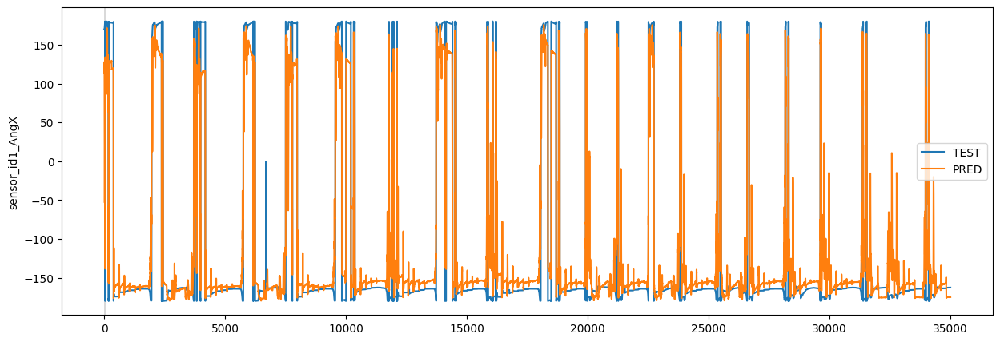

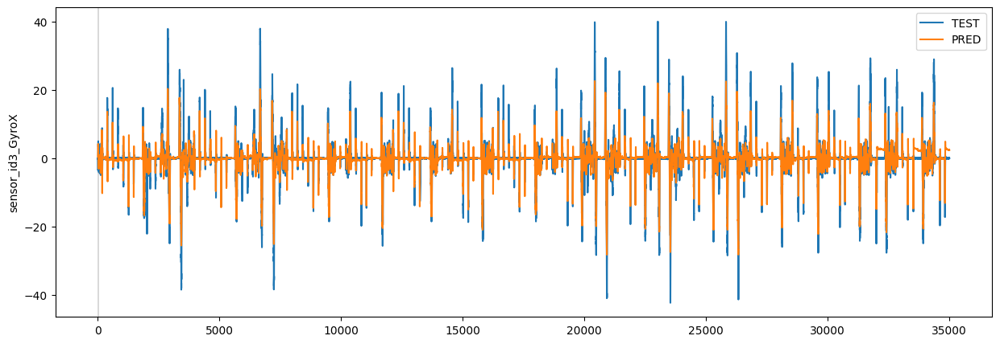

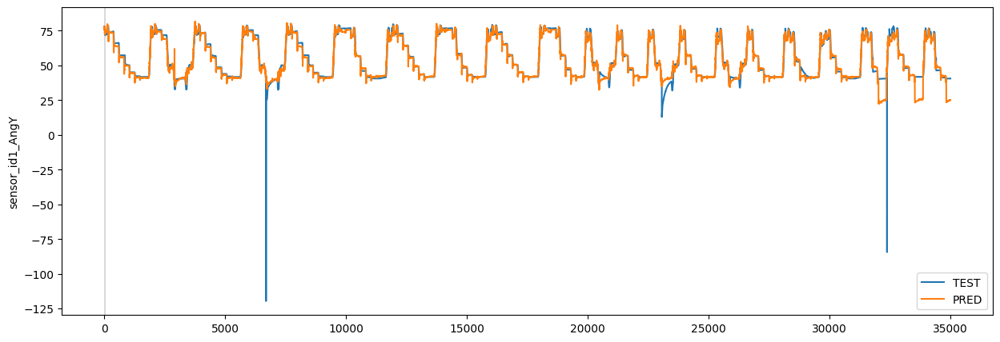

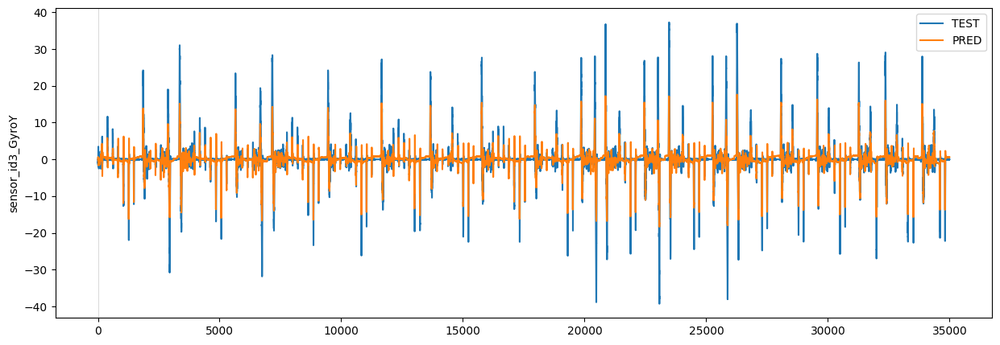

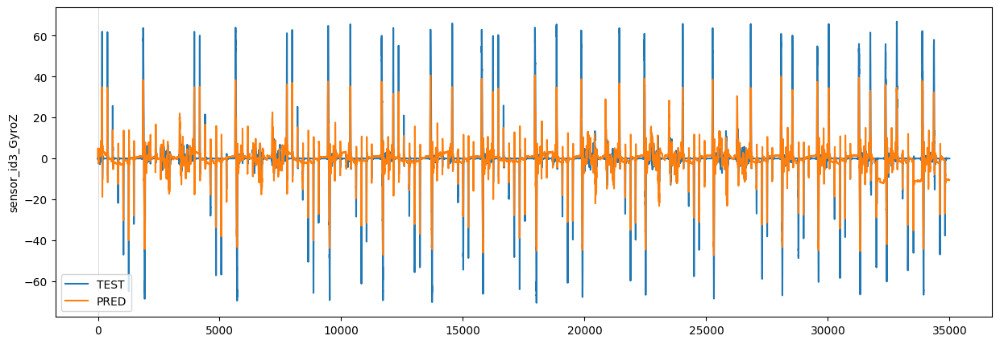

...

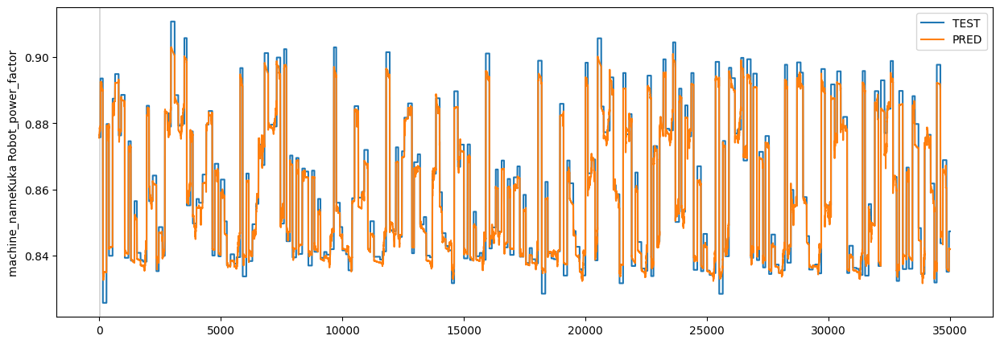

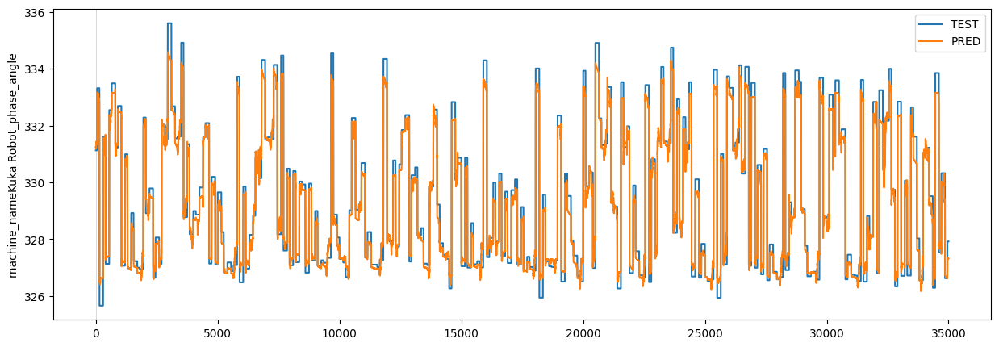

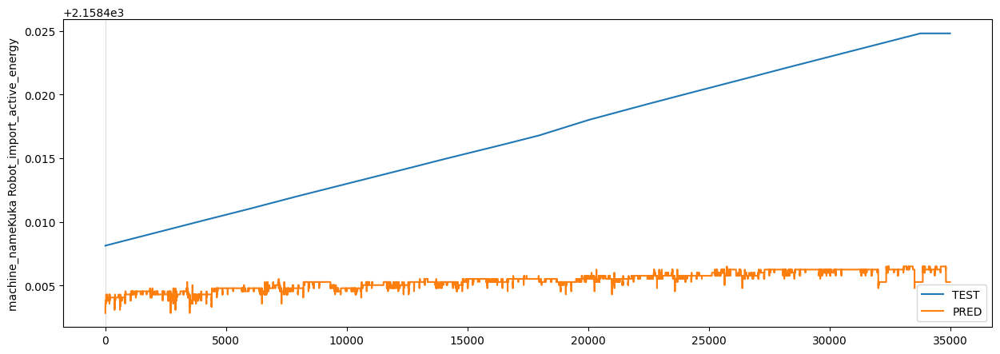

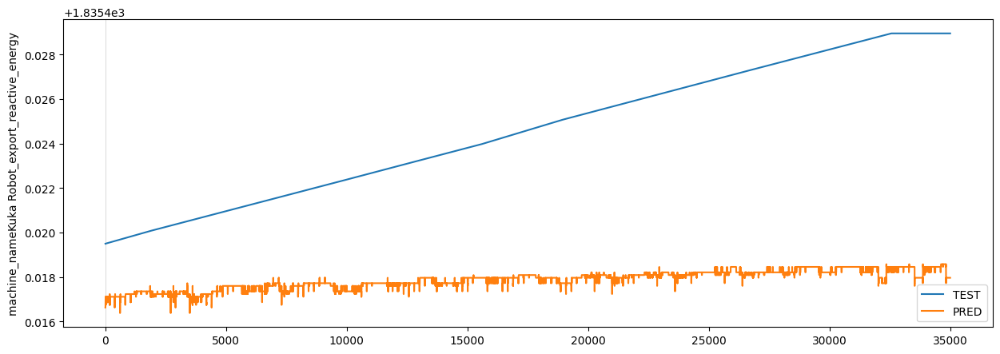

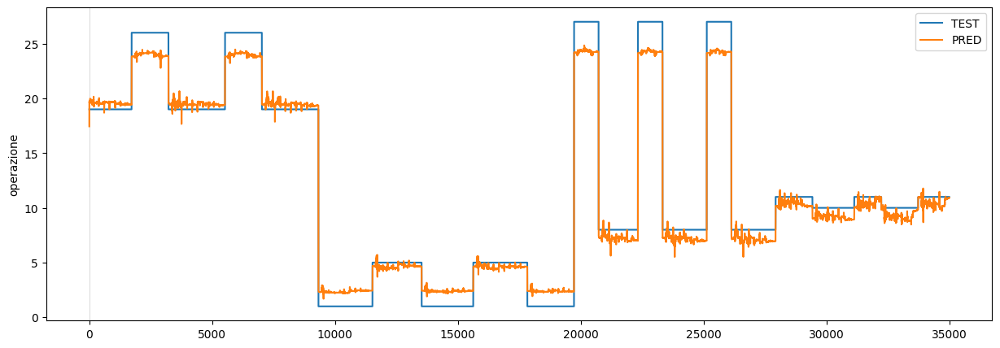

In [19]:
plot_comparison(start_idx=500, length=35000, train=False)

1/1 [==============================] - 2s 2s/step


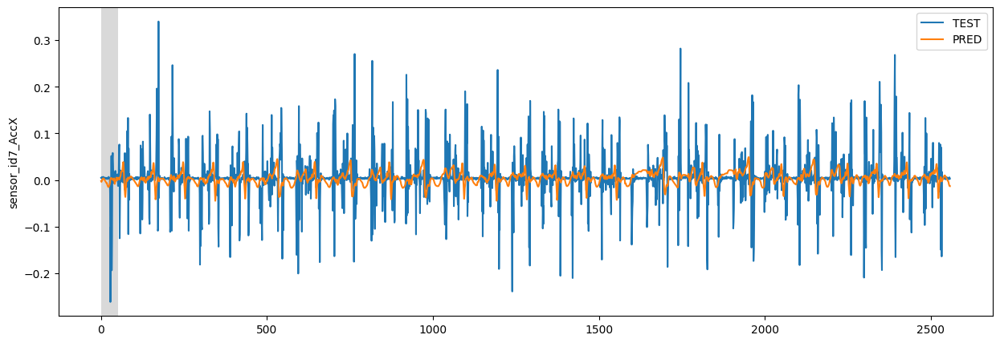

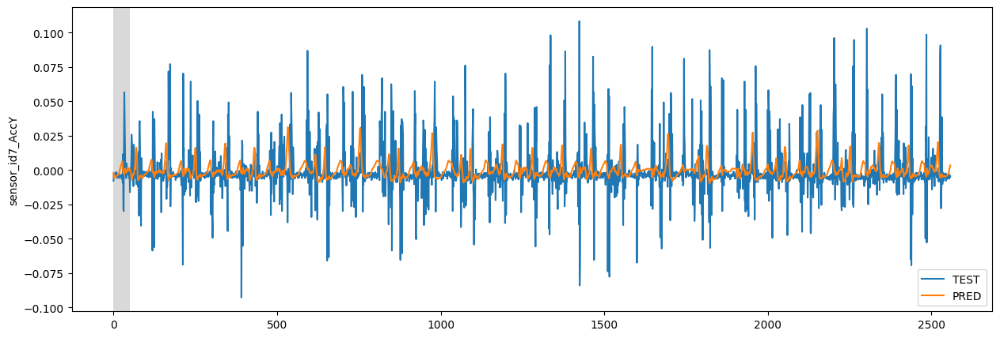

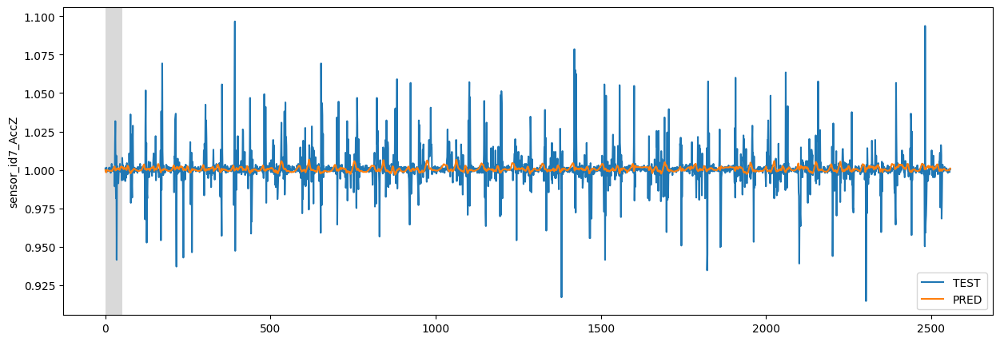

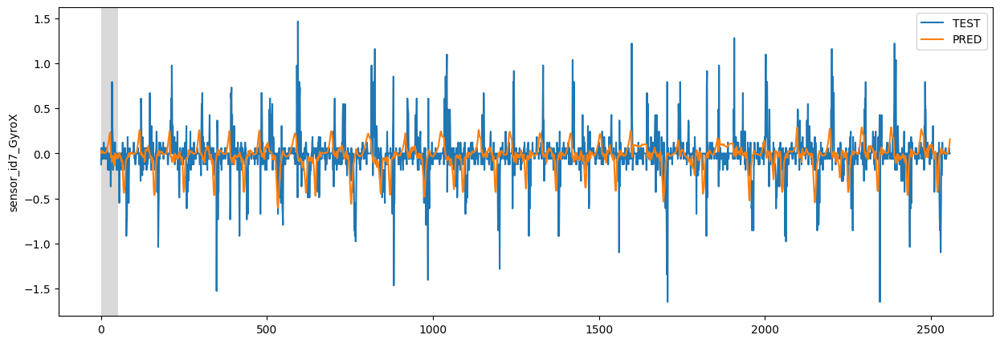

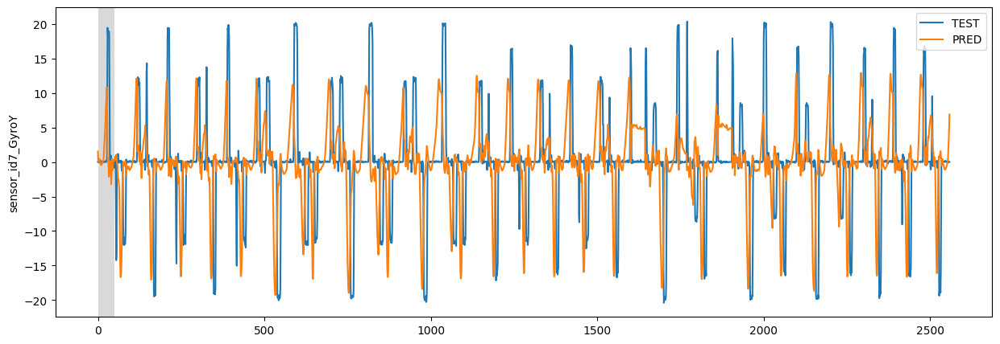

...

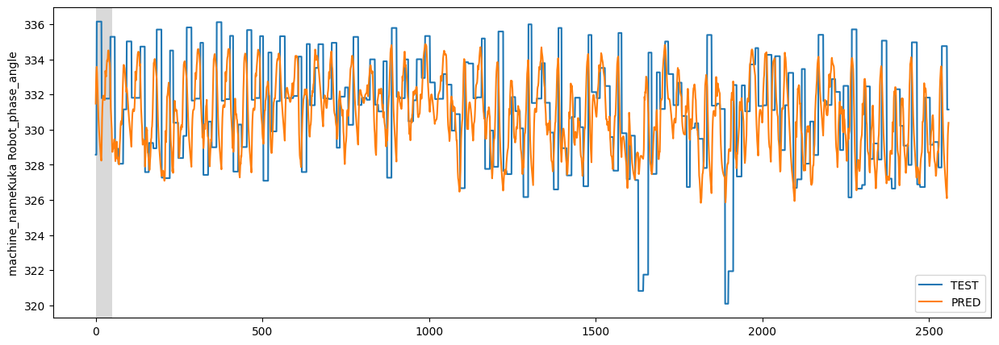

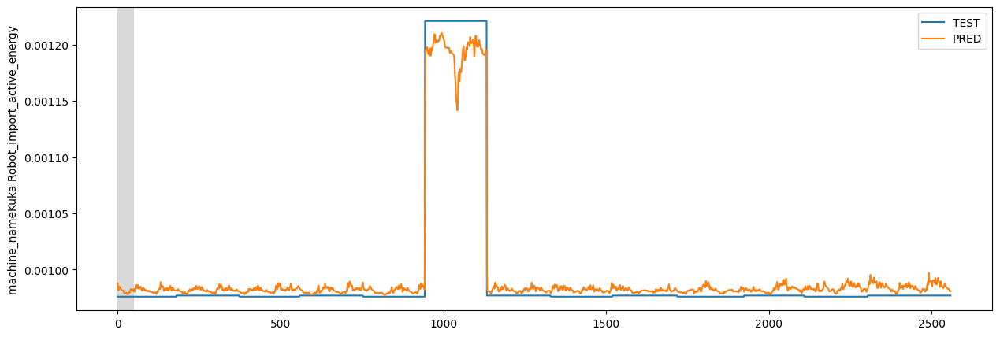

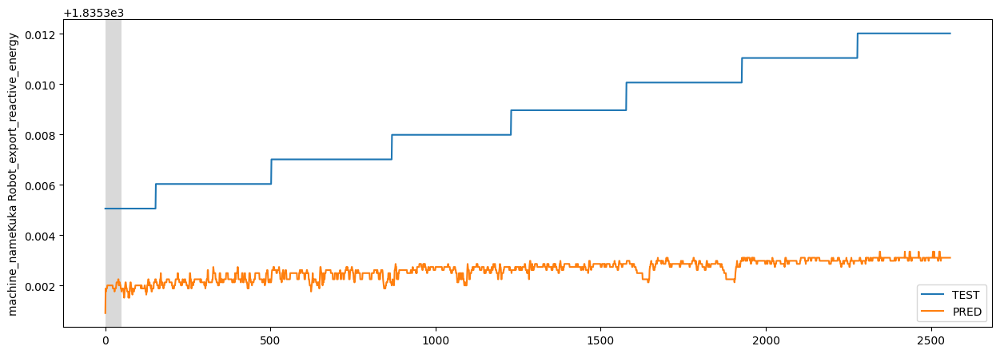

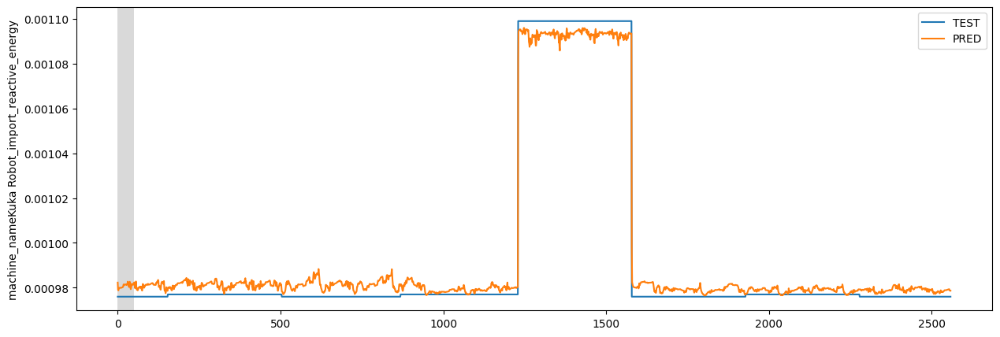

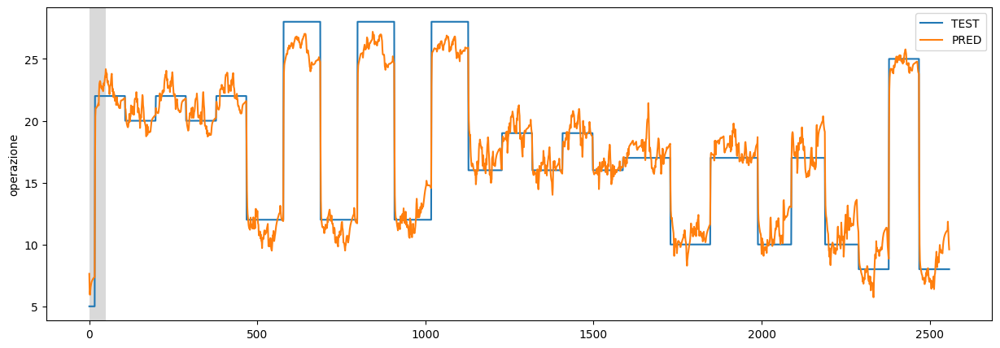

In [58]:
plot_comparison(start_idx=500, length=10000, train=False)

1/1 [==============================] - 8s 8s/step


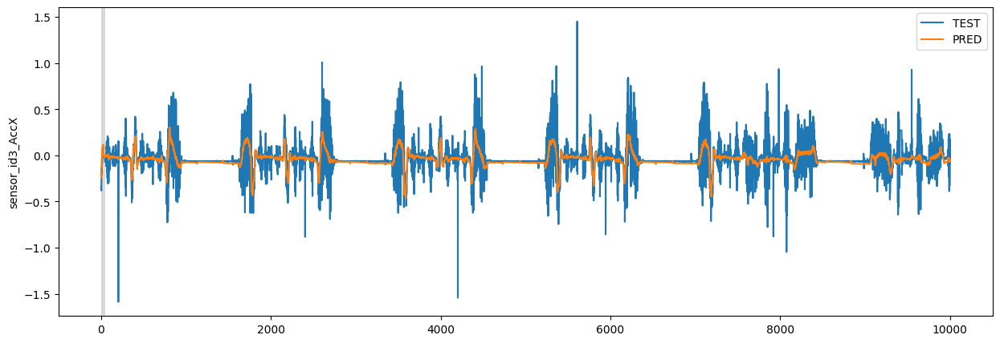

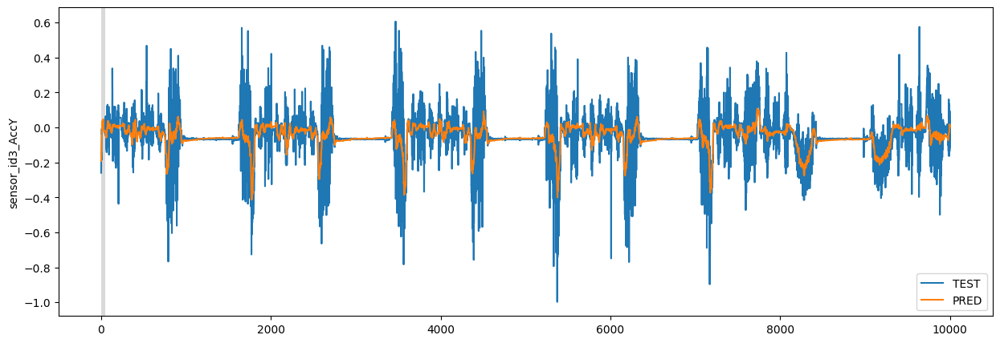

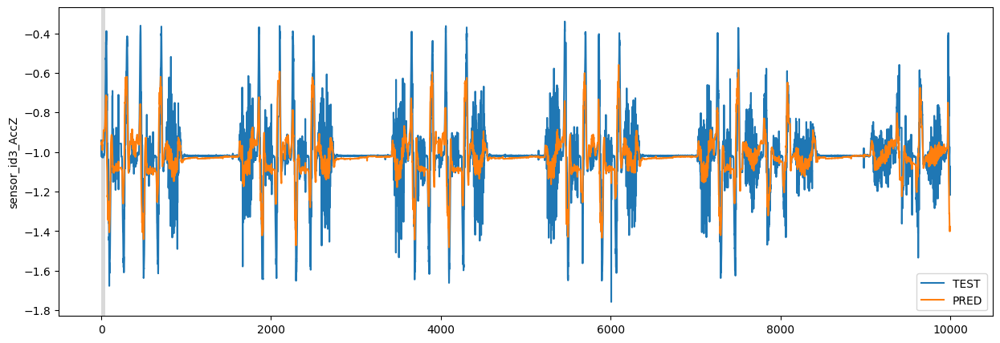

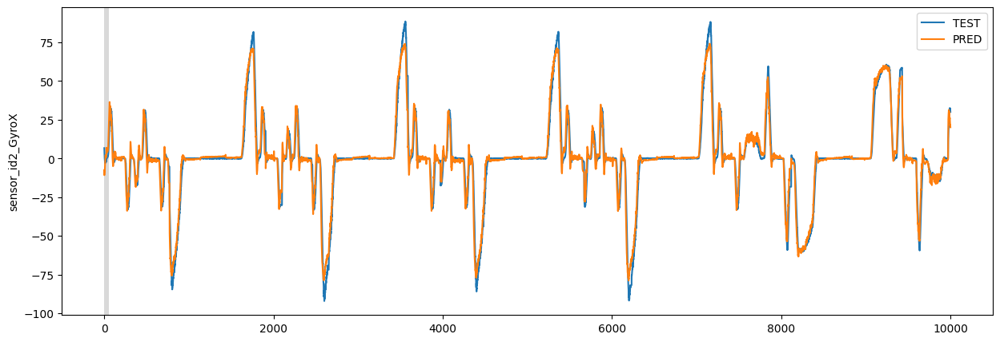

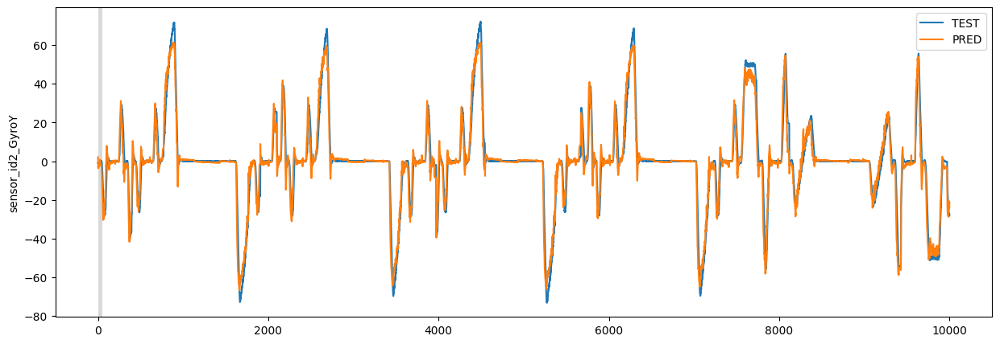

...

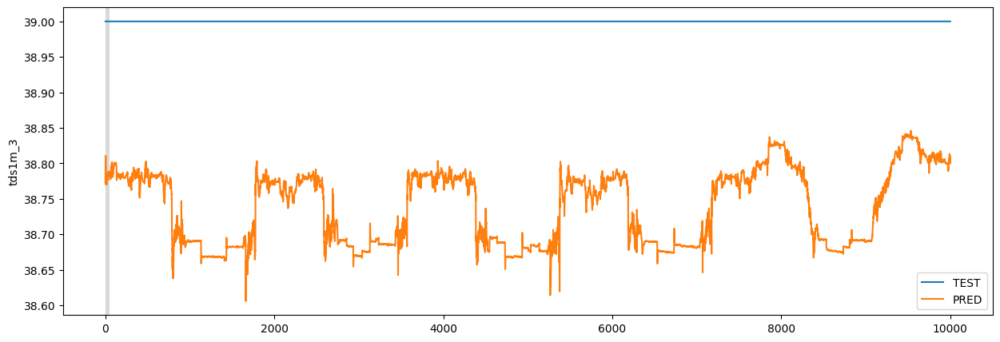

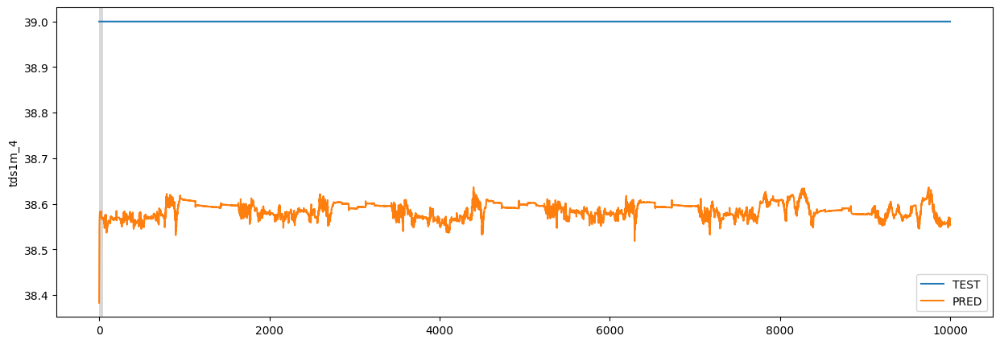

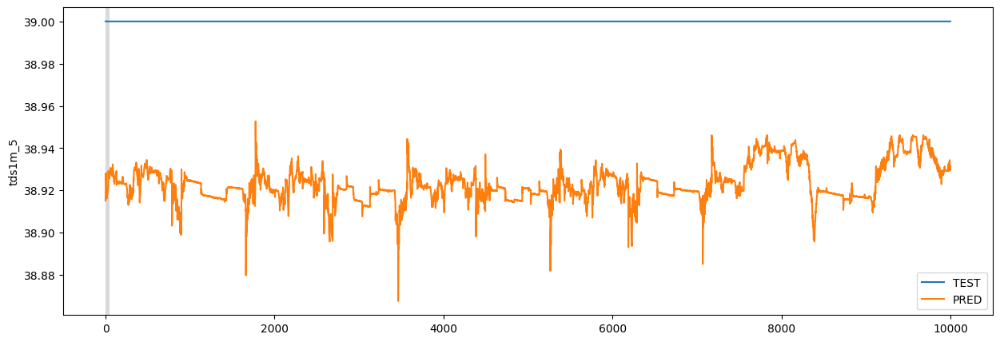

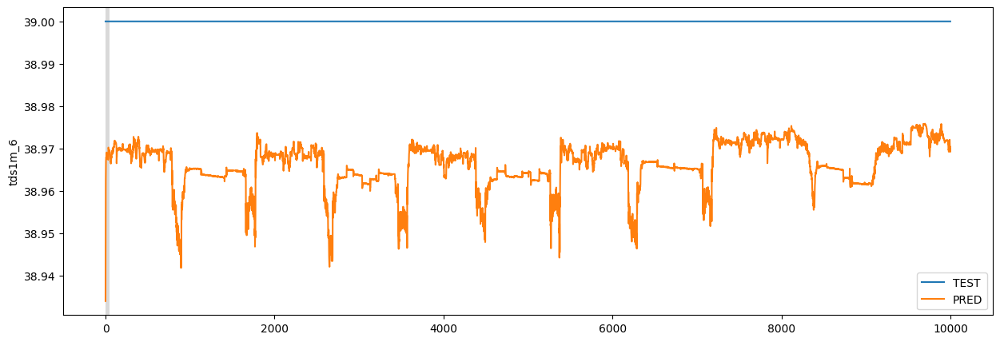

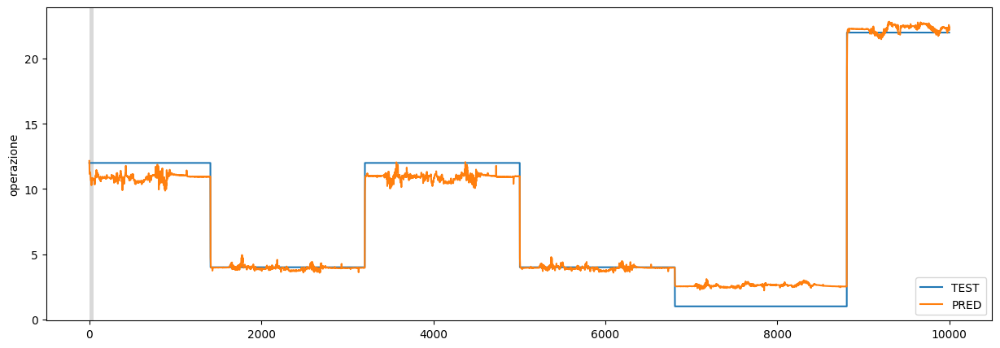

In [ ]:
plot_comparison(start_idx=5000, length=10000, train=False)

In [ ]:
df.size

82820752

In [ ]:
plot_comparison(start_idx=0, length=1000, train=False)

In [59]:
#CALCOLO L'ERRORE MEDIO DI OGNI COLONNA

x = x_test_scaled
y_true = y_test
    # Input-signals for the model.
x = np.expand_dims(x, axis=0)
# Use the model to predict the output-signals.
y_pred = model.predict(x)


    # The output of the model is between 0 and 1.
    # Do an inverse map to get it back to the scale
    # of the original data-set.
y_pred_rescaled = y_scaler.inverse_transform(y_pred[0]) #VALORI DELLE Y PREVISTE DAL MODELLO
x_rescaled = x_scaler.inverse_transform(x[0]) #VALORI EFFETTIVI DEL TEST SET
errore = 0
errore_tot = []
media_errore = []


differenze = [abs(x - y) for x, y in zip(y_pred_rescaled, x_rescaled)]
# Calcola la media delle differenze
media_differenze = sum(differenze) / len(differenze)
errore = pd.DataFrame([media_differenze])


differenze = [(abs(x - y)/y)*100 for x, y in zip(y_pred_rescaled, x_rescaled)]
media_differenze = sum(differenze) / len(differenze)
media_differenze = pd.Series(media_differenze)
errore = errore.append(media_differenze, ignore_index=True)


differenze = [pow((x - y),2) for x, y in zip(y_pred_rescaled, x_rescaled)]
media_differenze = sum(differenze) / len(differenze)
media_differenze = pd.Series(media_differenze)
errore = errore.append(media_differenze, ignore_index=True)


differenze = [pow((x - y),2) for x, y in zip(y_pred_rescaled, x_rescaled)]
differenze = sum(differenze) / len(differenze)
media_differenze = np.sqrt(differenze)
media_differenze = pd.Series(media_differenze)
errore = errore.append(media_differenze, ignore_index=True)



errore = errore.rename({errore.index[0]: 'MEAN ABSOLUTE ERROR'})
errore = errore.rename({errore.index[1]: 'MEAN ABSOLUTE PERCENTAGE ERROR'})
errore = errore.rename({errore.index[2]: 'MEAN SQUARED ERROR'})
errore = errore.rename({errore.index[3]: 'ROOT MEAN SQUARED ERROR'})






1/1 [==============================] - 3s 3s/step


<ipython-input-59-a8c0a3928b48>:27: RuntimeWarning: divide by zero encountered in divide
  differenze = [(abs(x - y)/y)*100 for x, y in zip(y_pred_rescaled, x_rescaled)]
<ipython-input-59-a8c0a3928b48>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  errore = errore.append(media_differenze, ignore_index=True)
<ipython-input-59-a8c0a3928b48>:36: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  errore = errore.append(media_differenze, ignore_index=True)
<ipython-input-59-a8c0a3928b48>:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  errore = errore.append(media_differenze, ignore_index=True)


In [ ]:
errore.head()

,0,1,2,3,4,5,6,7,8,9,...,88,89,90,91,92,93,94,95,96,97
MEAN ABSOLUTE ERROR,0.029256,0.011112,0.006448,0.168768,5.901748,24.697694,0.111985,0.181370,0.213093,0.076402,...,0.902382,0.133970,31.352981,29.794082,6.234107,0.021564,2.554778,0.010710,0.005651,1.351268
MEAN ABSOLUTE PERCENTAGE ERROR,inf,inf,0.643139,inf,inf,inf,54.093009,inf,inf,inf,...,0.395800,11.923308,16.446868,13.585138,-6.117297,2.485247,0.772043,0.000496,0.000308,12.904577
MEAN SQUARED ERROR,0.002532,0.000343,0.000153,0.071931,66.809845,1182.967838,0.028494,0.079235,0.090629,0.015303,...,1.124393,0.028877,1695.782251,1549.625088,64.969016,0.000821,11.040923,0.000129,0.000036,3.065766
ROOT MEAN SQUARED ERROR,0.050314,0.018514,0.012381,0.268200,8.173729,34.394299,0.168803,0.281486,0.301046,0.123706,...,1.060374,0.169932,41.179877,39.365278,8.060336,0.028650,3.322788,0.011364,0.006007,1.750933


In [60]:
row = errore.iloc[0]
print("MEAN ABSOLUTE ERROR:", row.mean())

row = errore.iloc[1]
print("MEAN ABSOLUTE PERCENTAGE ERROR:", row.mean())

row = errore.iloc[2]
print("MEAN SQUARED ERROR:", row.mean())

row = errore.iloc[3]
print("ROOT MEAN SQUARED ERROR:", row.mean())


MEAN ABSOLUTE ERROR: 8.790923032998311
MEAN ABSOLUTE PERCENTAGE ERROR: inf
MEAN SQUARED ERROR: 689.7331629644488
ROOT MEAN SQUARED ERROR: 14.095797746879981
